In [1]:
from spleeter.separator import Separator
from spleeter.audio.adapter import AudioAdapter
import matplotlib.pyplot as plt
import librosa.display
from IPython.display import Audio

# Load Sample Song
- https://soundcloud.com/taehee-lee-671090884/dont-leave-me-hanging-on

/Users/brad/.pyenv/versions/3.7.9/envs/p37/lib/python3.7/site-packages/librosa/util/utils.py:200: UserWarning: librosa.util.frame called with axis=-1 on a non-contiguous input. This will result in a copy.
  "on a non-contiguous input. This will result in a copy.".format(axis)


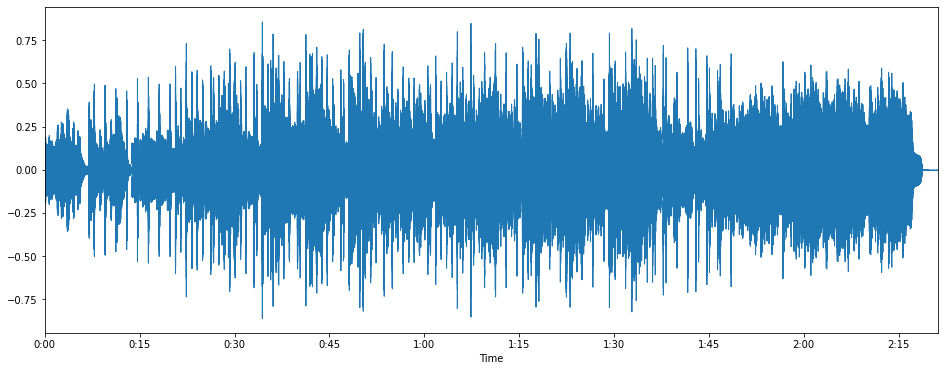

Process ForkPoolWorker-8:
Process ForkPoolWorker-4:
Process ForkPoolWorker-3:
Process ForkPoolWorker-15:
Process ForkPoolWorker-14:
Process ForkPoolWorker-5:
Process ForkPoolWorker-11:
Process ForkPoolWorker-6:
Process ForkPoolWorker-12:
Process ForkPoolWorker-2:
Process ForkPoolWorker-10:
Process ForkPoolWorker-16:
Process ForkPoolWorker-13:
Process ForkPoolWorker-1:
Process ForkPoolWorker-7:
Process ForkPoolWorker-9:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):


In [2]:
file_path = 'Don\'t Leave Me, Hanging On.mp3'
# file_path = 'audio_example.mp3'

separator = Separator('spleeter:2stems')

audio_loader = AudioAdapter.default()
waveform, sr = audio_loader.load(file_path)
sr = int(sr)

plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=waveform[:, 0], sr=sr)
plt.show()

# Separate Vocal and Background

In [3]:
prediction = separator.separate(waveform)

prediction

INFO:tensorflow:Apply unet for vocals_spectrogram
INFO:tensorflow:Apply unet for accompaniment_spectrogram
INFO:tensorflow:Restoring parameters from pretrained_models/2stems/model


{'vocals': array([[0.00232754, 0.00232977],
        [0.00364438, 0.00365104],
        [0.00481909, 0.0048305 ],
        ...,
        [0.        , 0.        ],
        [0.        , 0.        ],
        [0.        , 0.        ]], dtype=float32),
 'accompaniment': array([[-0.00106303, -0.00106497],
        [-0.00102861, -0.00103457],
        [-0.00101956, -0.00102984],
        ...,
        [ 0.        ,  0.        ],
        [ 0.        ,  0.        ],
        [ 0.        ,  0.        ]], dtype=float32)}

# Visualize Waveform

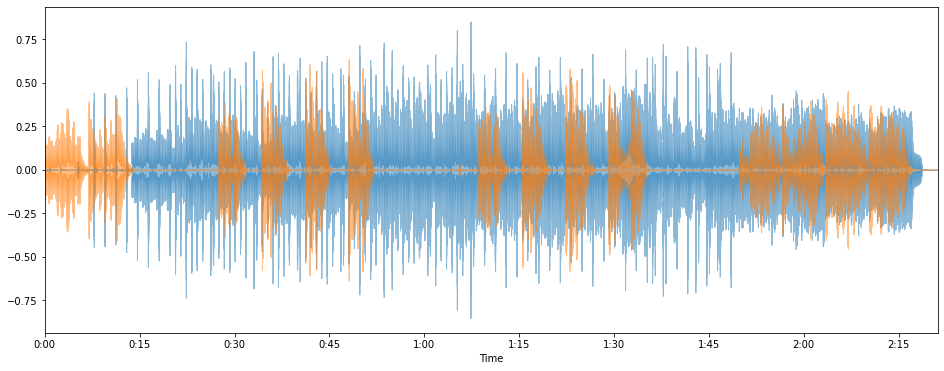

In [4]:
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=prediction['accompaniment'][:, 0], sr=sr, alpha=0.5)
librosa.display.waveplot(y=prediction['vocals'][:, 0], sr=sr, alpha=0.5)
plt.show()

# Preview Result

In [5]:
Audio(prediction['vocals'][:, 0], rate=sr)

In [6]:
Audio(prediction['accompaniment'][:, 0], rate=sr)

# Initialize Motor

In [7]:
from dynamikontrol import Module

module = Module()
module.motor.angle(0)

# Play!

In [15]:
import pyaudio
import numpy as np

chunk_size = 10240
multiplyer = 50000

p = pyaudio.PyAudio()
stream = p.open(
    format=p.get_format_from_width(4),
    channels=2,
    rate=sr,
    output=True
)

for i in range(0, len(waveform), chunk_size):
    amplitude = abs(int(prediction['vocals'][i: i + chunk_size, 0].mean() * multiplyer))
    module.motor.angle(-amplitude, period=chunk_size / sr)

    stream.write(waveform[i: i + chunk_size].astype(np.float32).tostring())
    module.motor.angle(0, period=0.1)
    
stream.close()